<span style="font-size: 6px; float:right">Notebook created by <a style="text-decoration: none; color:#000;" href="https://s.zymon.org">Szymon Woźniak</a></span>
<br>
<center><font size="6"><b>Digital Signal Processing Lab</b></font></center>
<br />
<center><font size="5"><b><u>Signal Quantization and Sampling Theorem</u></b></font></center>
<span style="float:right;"><b>Notebook version:</b> 0.3a</span>

My name is (put your name here).
If you have collaborated with other peers while working on this notebooke, please annouce theirs names below.
- name1
- name2

# Introduction

In this notebook, you are going to investigate two basic operations for transforming analog signals into digital,
sampling and quantization.

The notebook consists is a series of exercises that will help you gain practical knowledge with those two operations.


## Reading list

Before working with the notebook, you might find it useful to become acquainted with the following materials:
- <span style="font-size: 12px">Section "**QUANTIZATION NOISE MODEL**" from "Taking the Mystery out of the Infamous Formula, 'SNR = 6.02N + 1.76dB,' and Why You Should Care", available [here](https://www.analog.com/media/en/training-seminars/tutorials/MT-001.pdf).</span>
- <span style="font-size: 12px">Section **4.4 Widmo iloczynu i splotu dwóch sygnałów** from “Cyfrowe przetwarzanie sygnałów : od teorii do zastosowań, WKŁ 2014” by T. P. Zieliński.</span>
- <span style="font-size: 12px">Section **4.5 Twierdzenie o próbkowaniu** from “Cyfrowe przetwarzanie sygnałów : od teorii do zastosowań, WKŁ 2014” by T. P. Zieliński.</span>
- <span style="font-size: 12px">Section **4.6 Widmo sygnału spróbkowanego** from “Cyfrowe przetwarzanie sygnałów : od teorii do zastosowań, WKŁ 2014” by T. P. Zieliński.</span>

Optionally you can also read following materials:
- <span style="font-size: 12px">Section **7 Dyskretyzacja sygnałów analogowych** from “Cyfrowe przetwarzanie sygnałów : od teorii do zastosowań, WKŁ 2014” by T. P. Zieliński.</span>

## Notebook setup

In [2]:
# Easy path management
from pathlib import Path

# Simple HTTP requests
import requests

# NumPy package
import numpy as np

# Opening Waveform Audio File Format (*.wav)
from scipy.io import wavfile

# Opening images
from imageio import imread

# Audio class from ipython for displaying audio player in notebooks
from IPython.display import Audio

# tqdm for displaying nice progress bar
from tqdm.auto import tqdm

# Matplotlib for plotting figures
from matplotlib import pyplot as plt, rcParams, animation

# Set some parameters of packages
np.random.seed(69) # Set seed of the pseudorandom number generator
rcParams['animation.embed_limit'] = 100 # Set memory limit for embedded animations

In [3]:
def download(url, path):
    if not isinstance(path, Path):
        path = Path(path)
    if not path.is_file():
        r = requests.get(url)
        with open(path, "wb") as f:
            f.write(r.content)

In [4]:
urls = {
    "epic_sax_guy.wav": "http://sp-class.agh.edu.pl/samples/epic_sax_guy.wav",
    "speech0001.wav": "http://sp-class.agh.edu.pl/samples/speech0001.wav",
}

for filename, url in tqdm(urls.items()):
    download(url, filename)

  0%|          | 0/2 [00:00<?, ?it/s]

# Generation of basic signals

Please implement a few basic signals on your own.
Try to vectorize your operations whenever it is possible.

## Sinc function

[Sinc function](https://en.wikipedia.org/wiki/Sinc_function) 

$$\large
    \mathrm{sinc}\! \left( t \right) 
    =
    \begin{cases}
        1,                        & \text{if } t = 0  \\
        \frac{\sin \left(\pi t \right) }{\pi t}, & \text{if } t \neq 0 \\
    \end{cases}
$$

You might find function `where` from `numpy` package useful to implement `sinc`. The reference for `where` is [here](https://docs.scipy.org/doc/numpy/reference/generated/numpy.where.html).

In [5]:
def sinc(t):
    arr=[]
    for i in t:
        if (i == 0):
            arr.append(1)
        else:
            arr.append(np.sin(3.14*i)/(3.14*i))
    return arr

## Rectangular function

[Rectangular function](https://en.wikipedia.org/wiki/Rectangular_function)

$$\large
    \mathrm{rect}(t) =
    \begin{cases}
        0   & \text{if } |t| \geq 1\\
        1   & \text{if } |t| < 1\\
    \end{cases}
$$

You might find function `abs` from `numpy` package useful to implement `rect`. The reference for `rect` is [here](https://docs.scipy.org/doc/numpy/reference/generated/numpy.where.html).

In [6]:
def rect(t):
    arr=[]
    for i in t:
        if abs(i) >= 1:
            arr.append(0)
        else:
            arr.append(1)
    return arr

## Triangfular function

[Triangular function](https://en.wikipedia.org/wiki/Triangular_function)
$$\large
    \mathrm{tri}(t) =
    \begin{cases}
        0       & \text{if } |t| \geq 1\\
        1 - |t| & \text{if } |t| < 1\\
    \end{cases}
$$

Similary, function `maxiumum` from `numpy` might be usefule here. Reference for function is [here](https://numpy.org/doc/stable/reference/generated/numpy.where.html).

In [7]:
def tri(t):
    arr=[]
    for i in t:
        if abs(i) >= 1:
            arr.append(0)
        else:
            arr.append(1-abs(i))
    return arr

## Verify your functions

Check if your implementations generate those signals correctly.

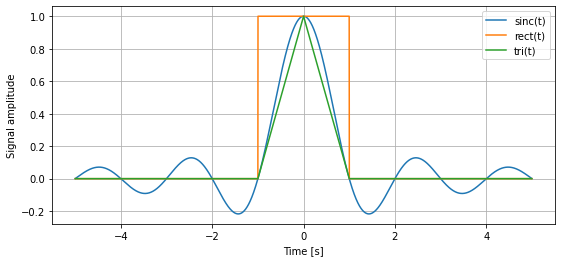

In [8]:
fs = 1000
dt = 1/fs
t = np.arange(-5, 5, dt)

plt.figure(figsize=(9, 4))

plt.plot(t, sinc(t), label='sinc(t)')
plt.plot(t, rect(t), label='rect(t)')
plt.plot(t, tri(t),  label='tri(t)')

plt.ylabel('Signal amplitude')
plt.xlabel('Time [s]')
plt.grid()
plt.legend()
plt.show()

# Generation of bandlimited function

In the further part of the notebook, you will need to generate some band-limited signals.
In this section of the notebook, you are going to implement a few utils for this purpose.

Any bandlimited signal can be represented in the following way
$$\large
    s(t) =
    \sum_{i=1}^{C}
    A_i \cdot \sin \left(
        2\pi f_i  t + \phi_i
    \right)
$$

where $A_i \in \mathbb{R}$ is an amplitude of $i$-th component, $f_i \in \mathbb{R}$ is an frequency of $i$-th component, and $\phi_i  \in (0, 2\pi)$ is an phase of $i$-th component.

## Random parameters

Implement function `rpobs` that will generate random parameters that will be later used for band-limited signal generation.
Note that function `rpobs` should return a tuple.

You can use function `rand` from `np.random` to generate samples from uniform distribution.

In [9]:
def rpobs(C=100, amp=1, f_s=0, f_e=1):
    """
    Random parameters of bandlimited signal 

    Parameters
    ----------
    C: int
        Number of sinusoidal components
    f_s: float
        Minimal frequency of signal
    f_e: float
        Maximal frequency of signal
    amp: float
        Amplitude of signal
    
    Returns
    -------
    F: numpy ndarray of shape (C, )
        A vector containing random frequencies between `f_s` and `f_e`
    A: numpy ndarray of shape (C, )
        A vector containing random amplitudes for each frequency component
    P: numpy ndarray of shape (C, )
        A vector containing random phase for each frequency component
    """
    
    F = np.random.random(C)*(f_e-f_s) + f_s
    A = np.random.random(C)*amp
    P = np.random.randint(0,360,C)
    
    return F, A, P

## Bandlimited signal

Implement a function that will generate a band-limited signal for given time vector and signal parameters.
Try to figure out how to not use any loops here.

In [10]:
def bl_signal(t, signal_parmas):
    [Fr,Am,Ph] = signal_parmas 
    wynik = np.zeros((np.size(t)))
    for ii in range(0,np.size(t)):
        for i in range(0,np.size(Fr)):
            wynik[ii] = wynik[ii] +  Am[i]*np.sin(t[ii]*Fr[i]+Ph[i])
    return wynik

## Random bandlimited signal param

Finally, combine the previous function to implement a function that will generate a random band-limited signal.

In [11]:
def rbl_signal(t, C=100, amp=1, f_s=0, f_e=1):
    """
    Random band-limited signal
    
    Parameters
    ----------
    t: numpy ndarray of shape (N, )
        A vector containing timestamps of the samples
    C: int
        Number of sinusoidal components
    f_s: float
        Minimal frequency of signal
    f_e: float
        Maximal frequency of signal
    amp: float
        Amplitude of signal
    Returns
    -------
    y: numpy ndarray of shape (N, )
        Bandlimited signal
    """
    
    F = np.random.random(C)*(f_e-f_s) + f_s
    A = np.random.random(C)*amp
    P = np.random.randint(0,360,C)
   
    wynik = np.zeros((np.size(t)))
    for ii in range(0,np.size(t)):
        for i in range(0,np.size(F)):
            wynik[ii] = wynik[ii] +  A[i]*np.sin(t[ii]*F[i]+P[i])
    return wynik

## Verify your implementations

In [12]:
# Sampling frequency
fs = 1000

# Sampling interval
dt = 1/fs

# Vector containing timestamps of samples
t = np.arange(-3, 5, dt)

# Generate parameters for bandlimited signal
bls_params = rpobs(C=1000, amp=1, f_s=0, f_e=2)

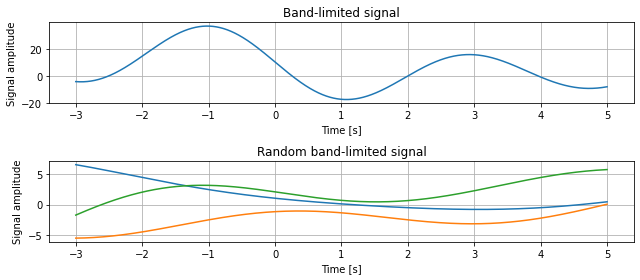

In [13]:
fig, (ax1, ax2) = plt.subplots(nrows=2, ncols=1, figsize=(9, 4))

ax1.plot(t, bl_signal(t, bls_params))
ax1.set_ylabel('Signal amplitude')
ax1.set_xlabel('Time [s]')
ax1.grid()
ax1.set_title("Band-limited signal")

for i in range(3):
    ax2.plot(t, rbl_signal(t))
ax2.set_ylabel('Signal amplitude')
ax2.set_xlabel('Time [s]')
ax2.grid()
ax2.set_title("Random band-limited signal")

plt.tight_layout()
plt.show()

# Signal quantization

Consider a quantization model $Q_L$ with $2^N$ quantization levels given by set $ L = \{l_1, l_2, \dots, l_{2^N} \} $.
The quantization model is definied by following function

$$\large
    Q_L(x) = \underset{l \in L}{\mathrm{argmin}} \lVert x - l \rVert_{2},
$$

where $ \lVert \cdot \rVert_{2}$ is an Euclidean norm.

Implement function `quantize` that will realize above quantization model.
You might find function `np.argmin` useful.

In [57]:
def quantize(signal, L):
    out = []
    for x in signal:
        normed = []
        for i in range(len(L)):
            normed.append(np.linalg.norm(x-L[i]))
        l_idx = np.argmin(normed)
        out.append(L[l_idx])

    return out
    """
    Quantize signal to given 
    
    Parameters
    ----------
    signal:  numpy ndarray of shape (N, )
        A vector containing samples of the signal
    levels:  numpy ndarray of shape (L, )
        A vector containing L quantization levels
    
    Returns
    -------
    q_s:  numpy ndarray of shape (N, )
        A vector containing quantized samples of the signal 
    """

Write a script in the cell below that will help you verify if your implementation is correct.

[-1.  -0.5  0.   0.5  1. ]
1.0


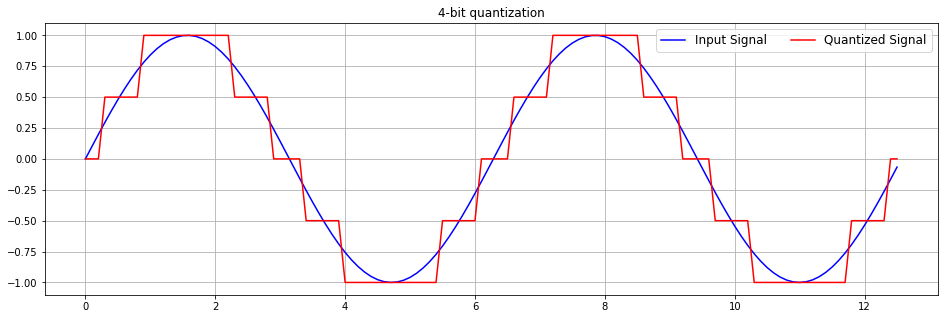

In [95]:
x = np.arange(0,4*np.pi,0.1)   # start,stop,step
y = np.sin(x)

y_s = -1
y_e = 1
# yt = (abs(y_s)+abs(y_e)/N) for N-bit converter
# for N=4
yt = 0.5
l = np.arange(y_s, y_e+dt ,yt)

quantized = quantize(y,l)
print(l)
print(max(l))

# Plot signal
fig, ax = plt.subplots(1, 1, figsize=(16, 5))

ax.plot(x,y,'b', label='Input Signal')
ax.plot(x,quantized,'r', label='Quantized Signal')
ax.legend(ncol=3, fontsize=12, loc='upper right')
ax.set_title("4-bit quantization")
ax.grid()
plt.show()

**Question**: Is quantization a linear transformation? Circumstantiate your answer.

**Anwser**: (Put your anwser here)

## Signal to Noise Ratio

Please implement two functions, one will compute the theoretical value of SNR for N-bit ADC and the second will compute SNR using samples of signal and quantization noise.

Afterward, compare theoretical and practical values for different band-limited signals and try to answer questions.

In [16]:
def SNR_theory(N):
    """
    Computes the theoretical value of the signal to noise ratio for N-bit Analog-Digital converter.
    
    Parameters
    ----------
    N: int
        Number of levels
        
    Returns
    -------
    SNR: float
        Theoretical value of SNR for N-bit ADC
    """
    
    raise NotImplementedError

In [17]:
def SNR(signal, noise):
    """
    Function computes Signal to Noise Ratio for given signal and noise
    
    Parameters
    ----------
    signal:  numpy ndarray of shape (N, )
        A vector containing samples of the signal
    noise:  numpy ndarray of shape (N, )
        A vector containing samples of the noise
    Returns
    -------
    SNR: float
        Signal to Noise Ratio in dB
    """
    
    raise NotImplementedError

In [18]:
# Place for your code

**Question**: Why theoretical and practical SNR differs?

**Anwser**: (Put your anwser here)

**Question**: For what family of signals you might expect that the difference between theoretical and practical SNR will be small (let's say less than 0.5 dB) and why?

**Anwser**: (Put your anwser here)

**Question**: For what practical cases assumed quantization error model fails?

**Anwser**: (Put your anwser here)

## Quantization of audio signals

Quantize available audio signal, for example "speech0001.wav" or "epic_sax_guy.wav", and listen how they sounds for small values of $N = 2, 3, 4$. 

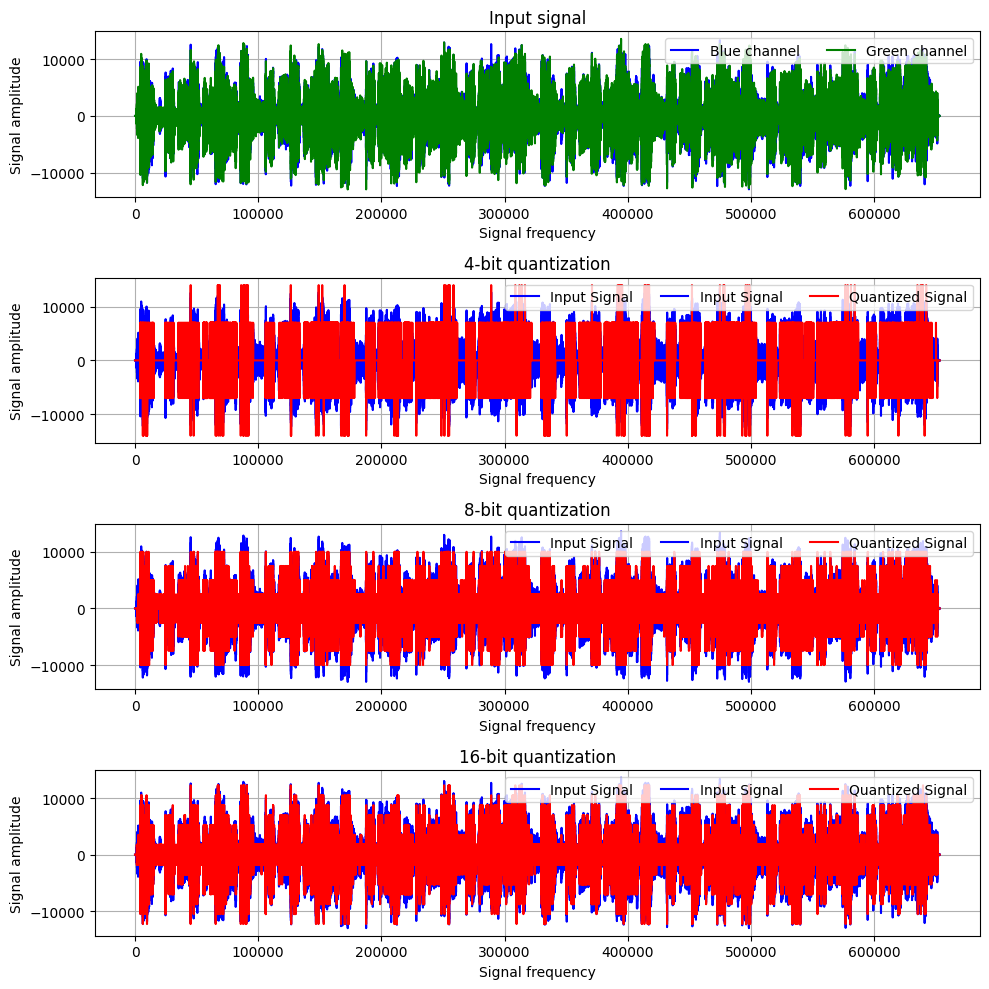

In [110]:
# Put your code here
from scipy.io import wavfile
fs, y = wavfile.read('epic_sax_guy.wav')

y_s = -14000
y_e = 14000
# yt = (abs(y_s)+abs(y_e)/N) for N-bit converter

# for N=4
yt1 = 7000
l1 = np.arange(y_s, y_e+yt1 ,yt1)
quantized1 = quantize(y,l1)

# for N=8
yt2=3500
l2 = np.arange(y_s, y_e+yt2 ,yt2)
quantized3 = quantize(y,l2)

# for N=16
yt3=1750
l3 = np.arange(y_s, y_e+yt3 ,yt3)
quantized3 = quantize(y,l3)

# Plot signal
fig, axes = plt.subplots(4, 1, figsize=(10, 10),dpi=100)

arr1 = y[:,0]
arr2 = y[:,1]

axes[0].plot(arr1,'b',label="Blue channel")
axes[0].plot(arr2,'g',label="Green channel")
axes[0].set_title("Input signal")

axes[1].plot(y,'b', label='Input Signal')
axes[1].plot(quantized1,'r', label='Quantized Signal')
axes[1].set_title("4-bit quantization")

axes[2].plot(y,'b', label='Input Signal')
axes[2].plot(quantized2,'r', label='Quantized Signal')
axes[2].set_title("8-bit quantization")

axes[3].plot(y,'b', label='Input Signal')
axes[3].plot(quantized3,'r', label='Quantized Signal')
axes[3].set_title("16-bit quantization")


for ax in axes.flat:
    ax.grid()
    ax.legend(ncol=3, fontsize=10, loc='upper right')
    ax.set_xlabel("Signal frequency")
    ax.set_ylabel("Signal amplitude")

plt.tight_layout()
plt.show()


from IPython.display import Audio
Audio(quantized1, rate=fs)


**Question**: Explain why you can still understand the content of the audio signal after quantization with only 4 quantization levels.

**Anwser**: (Put your anwser here)

# Nyquist-Shannon Theorem and Signal Reconstruction


[Nyquist-Shannon sampling theorem](https://en.wikipedia.org/wiki/Nyquist%E2%80%93Shannon_sampling_theorem) says in short:

> If a function $x ( t )$ contains no frequencies higher than $B$ [Hz], it is completely determined by giving its ordinates at a series of points  spaced $\frac{1}{2B}$ seconds apart.
>
> -- <cite>Claude Shannon</cite>


## Signal Reconstruction

Whittaker–Shannon interpolation formula is given as

$$\Large
    x(t)
    =
    \sum^{+\infty}_{n=-\infty}
    x \left( n\Delta{}t \right)
    \mathrm{sinc} \! \left(
        \frac{t-n\Delta{}t}{\Delta{}t}
    \right)
$$

You can generate simple visualization of example signal reconstruction with a cell below. 

In [20]:
try:
    import spclass
    spclass.sampling.example_reconstruction()
except ImportError:
    print("spclass package is not available")

Plot generation:   0%|                                                                                        …

Please implement function `shannon_intrpolation` that will interpolate band-limited signal.

In [16]:
def shannon_interpoloation(t_i, t, x):
    """
    
    Paramters
    ---------
    t_i: numpy ndarray of shape (M, )
        A vector containing timestamps where signal will be interpolated.
        M is the number of samples in reconstructed signal
        
    t: numpy ndarray of shape (N, )
        A vector containing timestamps of consecutive samples.
        N is number of samples.
        
    samples: numpy ndarray of (N, )
        A vector containing samples of signal amplitude.
        
    Returns
    -------
    x_i: numpy ndarray of shape (M, )
        A vector containing interpolated (reconstucted) signal
    
    """
    dt = t[2]-t[1]
    x_i = []
    for i in range(len(t_i)):
        sum = 0
        for n in range(len(t)):
            sum = sum + (x[n]*np.sinc((t_i[i]-t[n])/dt))
        x_i.append(sum)
    return x_i

**Verify your implementation**

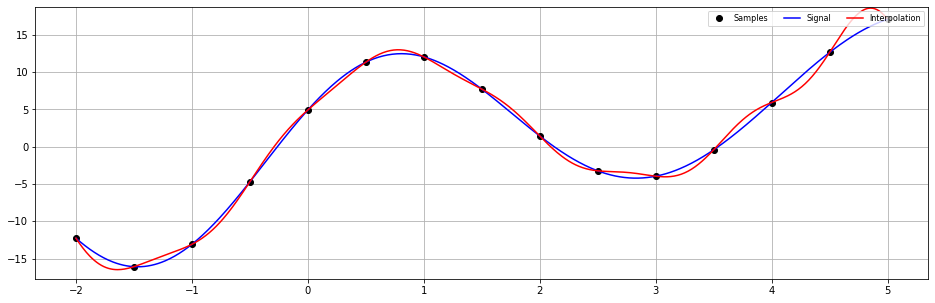

In [17]:
fs = 2 # Sampling frequency
dt = 1/fs # Sampling interval

# Generate timestamps of samples
t_s = -2
t_e = 5+dt
t = np.arange(t_s, t_e, dt)

# Generate samples of signal
s_params = rpobs(C=1000, f_e=2)
signal = lambda t: bl_signal(t, s_params)
x = signal(t)

# Generate oversamples signal
fsi = 100
dti = 1/fsi
ti = np.arange(t_s, t_e-dt, dti)
xo = signal(ti)

# Interpolate signal
xi = shannon_interpoloation(ti, t, x)

# Plot signal
fig, ax = plt.subplots(1, 1, figsize=(16, 5))

ax.plot(t, x,   'ko', label='Samples')
ax.plot(ti, xo, 'b-', label='Signal')
ax.plot(ti, xi, 'r-', label='Interpolation')
ax.grid()
ax.set_ylim([xo.min()*1.1, xo.max()*1.1])
ax.legend(ncol=3, fontsize=8, loc='upper right')

plt.show()

## Reconstruction Error

The reconsturction error of a signal is given as 

$$\large
    \varepsilon (t_i) = | x_o(t_i) - x_r(t_i) |,
$$

where $x_o$ is original signal and $x_r$ is reconstructed signal.
Compute the reconstruction error for a bandlimited signal.

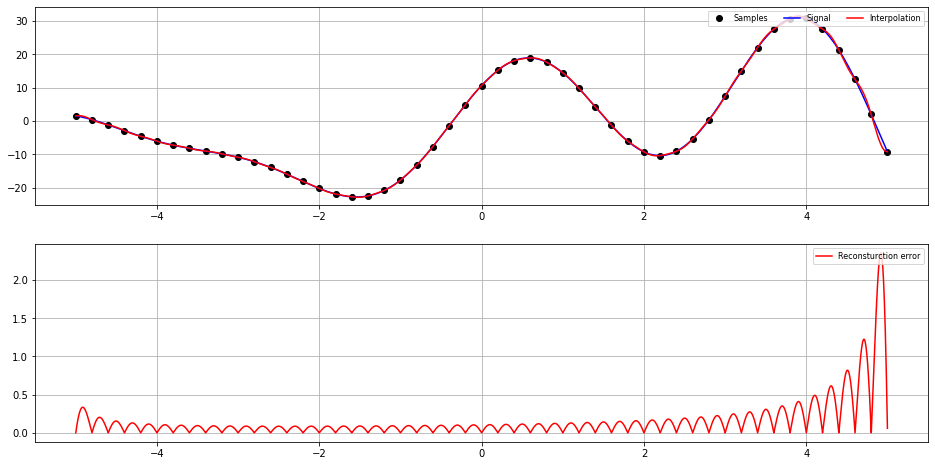

In [18]:
fs = 5 # Sampling frequency
dt = 1/fs # Sampling interval

# Generate timestamps of samples
t_s = -5
t_e = 5+dt
t = np.arange(t_s, t_e, dt)

# Generate samples of signal
s_params = rpobs(C=1000, f_e=2)
signal = lambda t: bl_signal(t, s_params)
x = signal(t)

# Generate oversamples signal
fsi = 1000
dti = 1/fsi
ti = np.arange(t_s, t_e-dt, dti)
xo = signal(ti)

# Interpolate signal
xi = shannon_interpoloation(ti, t, x)

# Compute reconstruction error
reconsturction_eps = []
for i in range(len(ti)):
    reconsturction_eps.append(abs(xo[i]-xi[i]))
#reconsturction_eps = ??? # Put your code here


fig, (ax, axe) = plt.subplots(2, 1, figsize=(16, 8))

ax.plot(t, x, 'ko', label='Samples')
ax.plot(ti, xo, 'b-', label='Signal')
ax.plot(ti, xi, 'r-', label='Interpolation')
ax.grid()
ax.legend()
ax.set_ylim([xo.min()*1.1, xo.max()*1.1])
ax.legend(ncol=3, fontsize=8, loc='upper right')

axe.plot(ti, reconsturction_eps, 'r-', label='Reconsturction error')
axe.grid()
axe.legend(ncol=1, fontsize=8, loc='upper right')
plt.show()

**Question**: Consider a case when the Shannon theorem is met. Explain why reconsturction error is not zero.

**Anwser**: (Put your anwser here)

Run the cell below and investigate how the reconsturction error changes when we are chaning the sampling frequency.

In [19]:
# Generate params of bandlimited signal
signal_params = rpobs(f_e=10)

# Define bandlimited signal
signal_func = lambda t: bl_signal(t, signal_params)

try:
    import spclass
    # Generate plot
    spclass.sampling.interactive_reconstruction(
        shannon_interpoloation,  # Interpolation function
        signal_func,             # Function that generates signal
        np.arange(5, 35, 0.1),   # Frequencies
        np.arange(0, 2, 1/200),  # Timestamps of oversamples signal
    )
except ImportError:
    print("spclass package is not available")

**Question**: Why reconstruction error is always bigger at the begining and the end of the signal when sampling frequency meets sampling theorem?

**Anwser**: (Put your anwser here)

## Plot RMSE characteristics

Your goal in this task is to investigate the [Root Mean Square Error (RMSE)](https://en.wikipedia.org/wiki/Root-mean-square_deviation) of reconstruction error for band limited signals in terms
of sampling frequency.
Generate a figure which will show how `RMSE` of a few band-limited signals (with different maximal frequency) is changing over a range of sampling frequencies.
You should use function `bl_signal` to realize this task.

$$\large
    \mathrm{RMSE}
    \left(
        x_o, x_r
    \right)
    = 
    \sqrt{
        \sum_{i=0}^{N}
        \frac{
            \varepsilon^2\!\!\left( t_i \right)
        }{
            N
        }
    }
$$

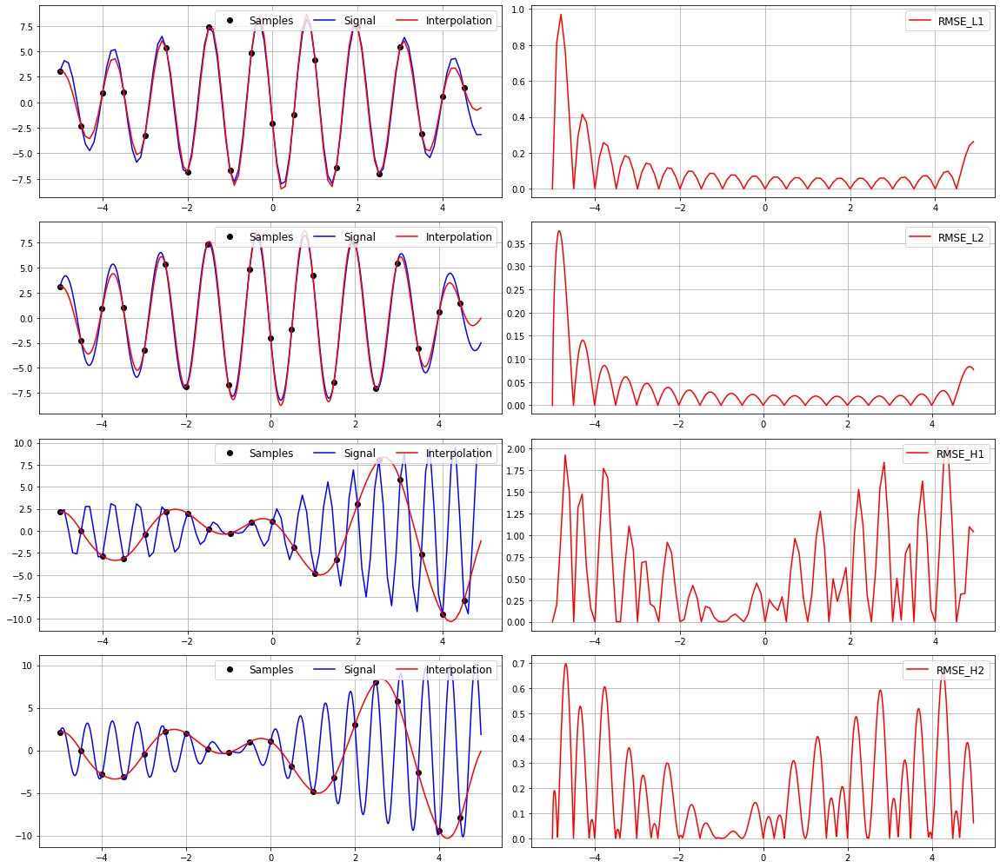

In [68]:
fs = 2 # Sampling frequency

dt = 1/fs # Sampling interval

# Generate timestamps of samples
t = np.arange(-5,5,dt)

# Generate samples of signal
s_params_1 = rpobs(C=100, amp=1, f_s=5, f_e=6) # With low frequency
s_params_2 = rpobs(C=100, amp=1, f_s=10, f_e=11) # With higher frequency

signal_1 = lambda t: bl_signal(t, s_params_1) # With low frequency
signal_2 = lambda t: bl_signal(t, s_params_2) # With higher frequency

x_L = signal_1(t) # Low frequency 
x_H = signal_2(t) # Higher frequency

# Generate oversamples signal
fsi1 = 10
fsi2 = 100
dti1 = 1/fsi1
dti2 = 1/fsi2
t_i1 = np.arange(-5,5,dti1)
t_i2 = np.arange(-5,5,dti2)
xo_L1 = signal_1(t_i1)
xo_L2 = signal_1(t_i2)
xo_H1 = signal_2(t_i1)
xo_H2 = signal_2(t_i2)

# Interpolate signal
xi_L1 = shannon_interpoloation(t_i1, t, x_L)
xi_L2 = shannon_interpoloation(t_i2, t, x_L)
xi_H1 = shannon_interpoloation(t_i1, t, x_H)
xi_H2 = shannon_interpoloation(t_i2, t, x_H)

# Compute reconstruction error
reconsturction_eps_L1 = []
for i in range(len(t_i1)):
    reconsturction_eps_L1.append(abs(xo_L1[i]-xi_L1[i]))
    
reconsturction_eps_L2 = []
for i in range(len(t_i2)):
    reconsturction_eps_L2.append(abs(xo_L2[i]-xi_L2[i]))
    
reconsturction_eps_H1 = []
for i in range(len(t_i1)):
    reconsturction_eps_H1.append(abs(xo_H1[i]-xi_H1[i]))
    
reconsturction_eps_H2 = []
for i in range(len(t_i2)):
    reconsturction_eps_H2.append(abs(xo_H2[i]-xi_H2[i]))
    
#Compute Root Mean Square Error (RMSE)

RMSE_L1 = []
for i in range(len(t_i1)):
    RMSE_L1.append(np.sqrt(reconsturction_eps_L1[i]**2/(i+1)))
    
RMSE_L2 = []
for i in range(len(t_i2)):
    RMSE_L2.append(np.sqrt(reconsturction_eps_L2[i]**2/(i+1)))
    
RMSE_H1 = []
for i in range(len(t_i1)):
    RMSE_H1.append(np.sqrt(reconsturction_eps_H1[i]**2/(i+1)))
    
RMSE_H2 = []
for i in range(len(t_i2)):
    RMSE_H2.append(np.sqrt(reconsturction_eps_H2[i]**2/(i+1)))



fig, ax = plt.subplots(nrows=4, ncols=2, figsize=(16, 14))

ax[0,0].plot(t, x_L,   'ko', label='Samples')
ax[0,0].plot(t_i1, xo_L1, 'b-', label='Signal')
ax[0,0].plot(t_i1, xi_L1, 'r-', label='Interpolation')

ax[0,1].plot(t_i1, RMSE_L1, 'r-', label='RMSE_L1')

ax[1,0].plot(t, x_L,   'ko', label='Samples')
ax[1,0].plot(t_i2, xo_L2, 'b-', label='Signal')
ax[1,0].plot(t_i2, xi_L2, 'r-', label='Interpolation')

ax[1,1].plot(t_i2, RMSE_L2, 'r-', label='RMSE_L2')

ax[2,0].plot(t, x_H,   'ko', label='Samples')
ax[2,0].plot(t_i1, xo_H1, 'b-', label='Signal')
ax[2,0].plot(t_i1, xi_H1, 'r-', label='Interpolation')

ax[2,1].plot(t_i1, RMSE_H1, 'r-', label='RMSE_H1')

ax[3,0].plot(t, x_H,   'ko', label='Samples')
ax[3,0].plot(t_i2, xo_H2, 'b-', label='Signal')
ax[3,0].plot(t_i2, xi_H2, 'r-', label='Interpolation')

ax[3,1].plot(t_i2, RMSE_H2, 'r-', label='RMSE_H2')

for axes in ax.flat:
    axes.grid()
    axes.legend(ncol=3, fontsize=12, loc='upper right')


plt.tight_layout()
plt.show()